In [ ]:
import pandas as pd
file_path = "/content/phone_usage_india.csv"
df = pd.read_csv(file_path)
print(df.head())

  User ID  Age  Gender   Location Phone Brand       OS  Screen Time (hrs/day)  \
0  U00001   53    Male     Mumbai        Vivo  Android                    3.7   
1  U00002   60   Other      Delhi      Realme      iOS                    9.2   
2  U00003   37  Female  Ahmedabad       Nokia  Android                    4.5   
3  U00004   32    Male       Pune     Samsung  Android                   11.0   
4  U00005   16    Male     Mumbai      Xiaomi      iOS                    2.2   

   Data Usage (GB/month)  Calls Duration (mins/day)  Number of Apps Installed  \
0                   23.9                       37.9                       104   
1                   28.1                       13.7                       169   
2                   12.3                       66.8                        96   
3                   25.6                      156.2                       146   
4                    2.5                      236.2                        86   

   Social Media Time (hrs/

In [ ]:
print(df.isnull().sum())

User ID                         0
Age                             0
Gender                          0
Location                        0
Phone Brand                     0
OS                              0
Screen Time (hrs/day)           0
Data Usage (GB/month)           0
Calls Duration (mins/day)       0
Number of Apps Installed        0
Social Media Time (hrs/day)     0
E-commerce Spend (INR/month)    0
Streaming Time (hrs/day)        0
Gaming Time (hrs/day)           0
Monthly Recharge Cost (INR)     0
Primary Use                     0
dtype: int64


In [ ]:
import pandas as pd
file_path = "phone_usage_india.csv"
df = pd.read_csv(file_path)
df.columns = df.columns.str.strip().str.lower().str.replace(' ', '_')
print(df.columns)
numerical_cols = [
    "screen_time_(hrs/day)", "data_usage_(gb/month)", "calls_duration_(mins/day)",
    "number_of_apps_installed", "social_media_time_(hrs/day)", "e-commerce_spend_(inr/month)",
    "streaming_time_(hrs/day)", "gaming_time_(hrs/day)", "monthly_recharge_cost_(inr)"
]
missing_cols = [col for col in numerical_cols if col not in df.columns]
if missing_cols:
    print("Columns not found:", missing_cols)
else:
    for col in numerical_cols:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        df = df[(df[col] >= lower_bound) & (df[col] <= upper_bound)]
    print("Outliers removed successfully!")
df.to_csv("cleaned_phone_usage_data.csv", index=False)
print(df.head())

Index(['user_id', 'age', 'gender', 'location', 'phone_brand', 'os',
       'screen_time_(hrs/day)', 'data_usage_(gb/month)',
       'calls_duration_(mins/day)', 'number_of_apps_installed',
       'social_media_time_(hrs/day)', 'e-commerce_spend_(inr/month)',
       'streaming_time_(hrs/day)', 'gaming_time_(hrs/day)',
       'monthly_recharge_cost_(inr)', 'primary_use'],
      dtype='object')
Outliers removed successfully!
  user_id  age  gender   location phone_brand       os  screen_time_(hrs/day)  \
0  U00001   53    Male     Mumbai        Vivo  Android                    3.7   
1  U00002   60   Other      Delhi      Realme      iOS                    9.2   
2  U00003   37  Female  Ahmedabad       Nokia  Android                    4.5   
3  U00004   32    Male       Pune     Samsung  Android                   11.0   
4  U00005   16    Male     Mumbai      Xiaomi      iOS                    2.2   

   data_usage_(gb/month)  calls_duration_(mins/day)  number_of_apps_installed  \
0     

In [ ]:
print(df.isnull().sum())

user_id                         0
age                             0
gender                          0
location                        0
phone_brand                     0
os                              0
screen_time_(hrs/day)           0
data_usage_(gb/month)           0
calls_duration_(mins/day)       0
number_of_apps_installed        0
social_media_time_(hrs/day)     0
e-commerce_spend_(inr/month)    0
streaming_time_(hrs/day)        0
gaming_time_(hrs/day)           0
monthly_recharge_cost_(inr)     0
primary_use                     0
dtype: int64


<Figure size 1000x600 with 0 Axes>

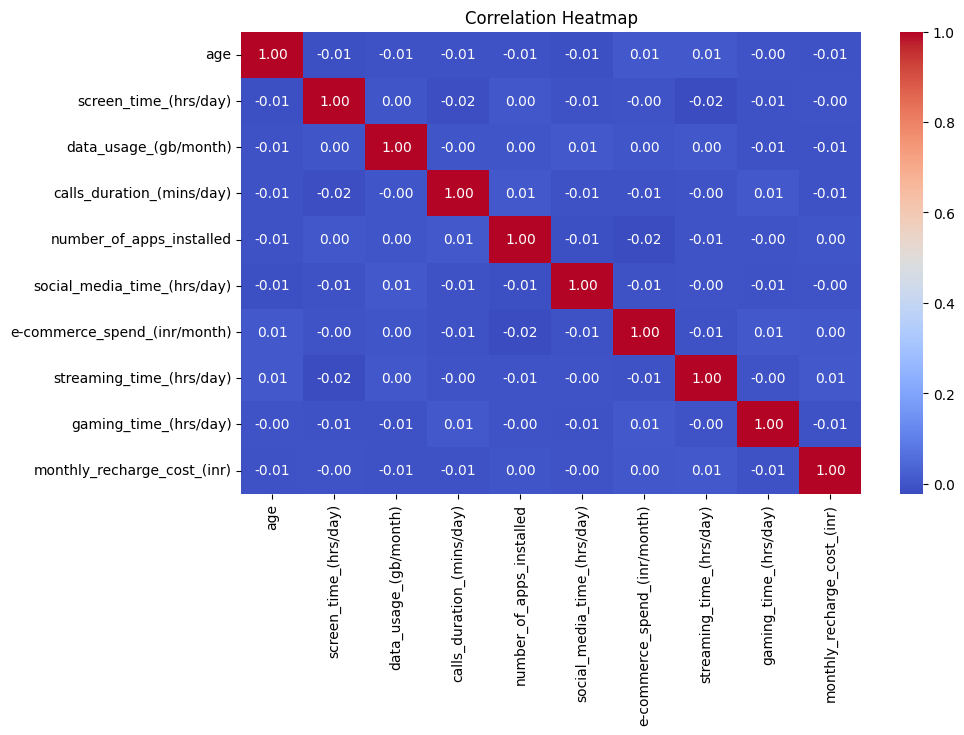

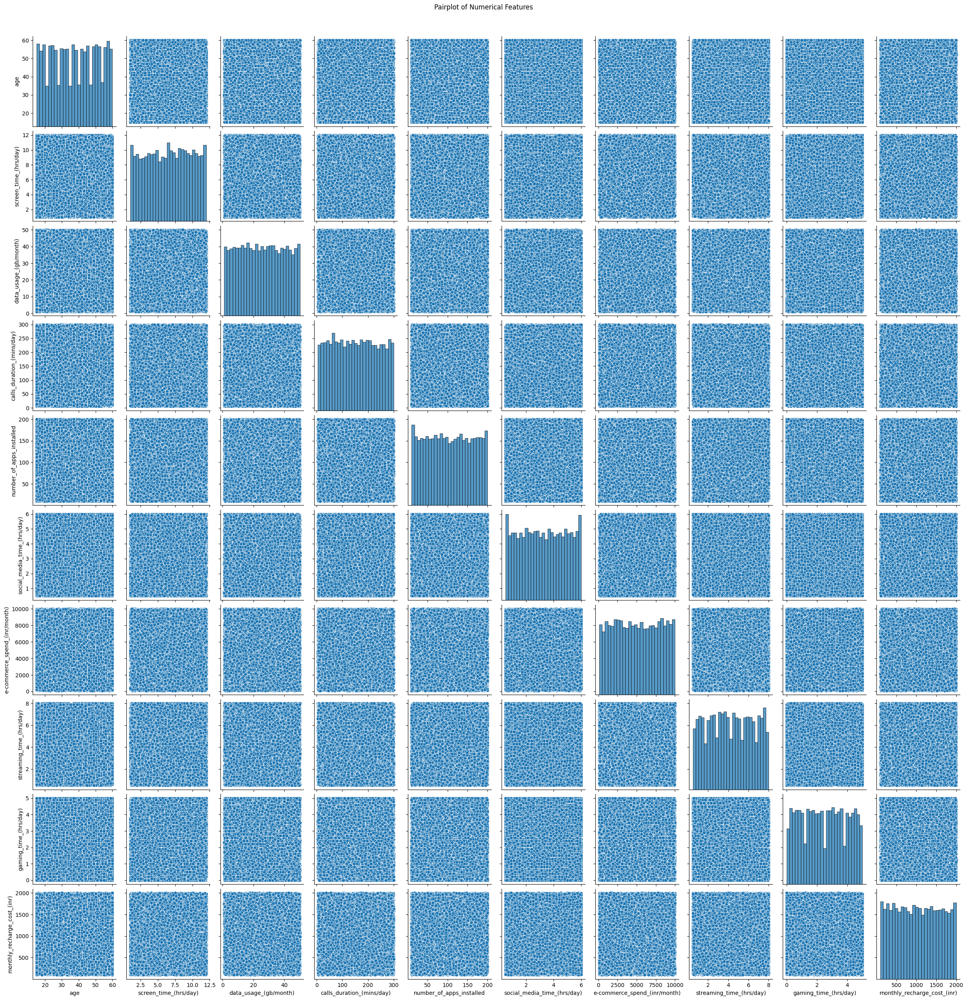

<Figure size 1200x800 with 0 Axes>

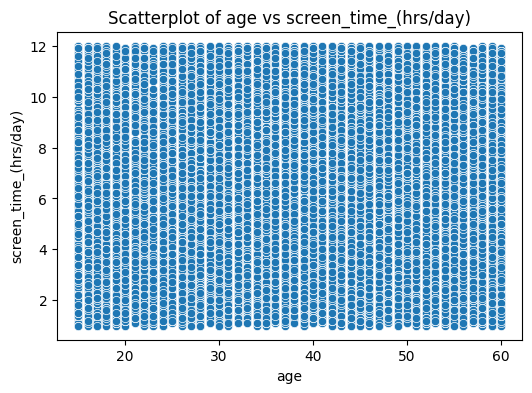

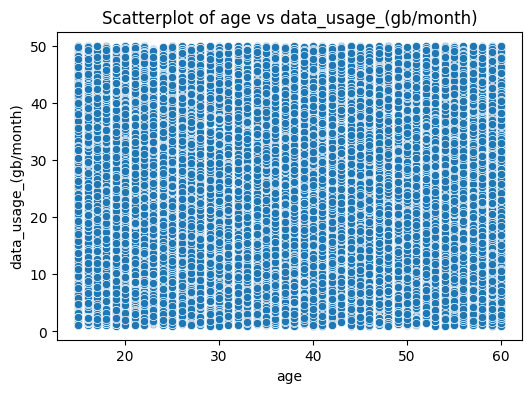

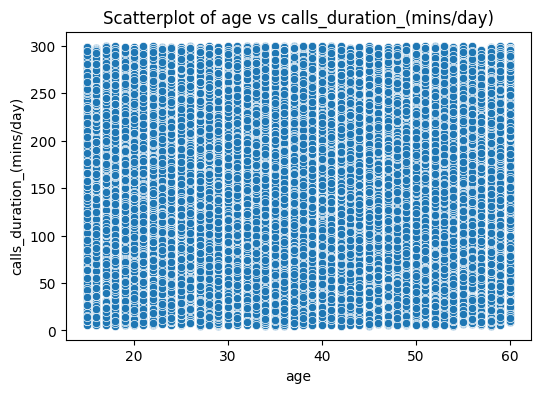

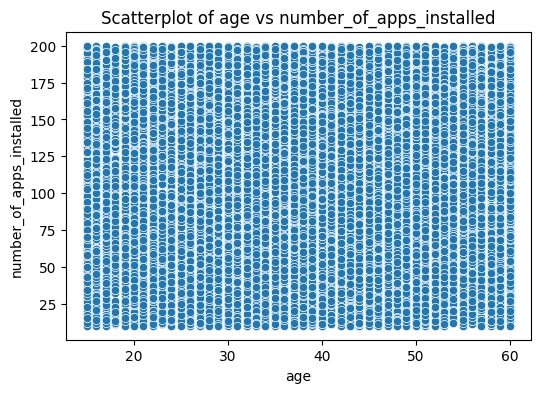

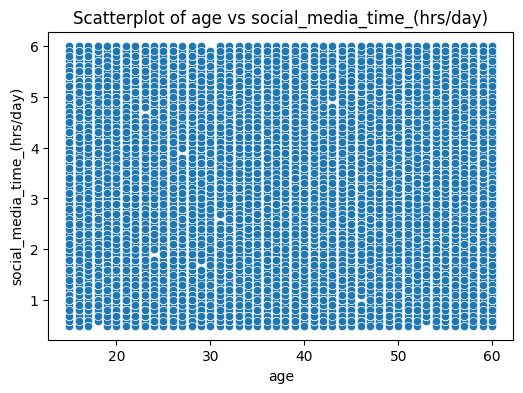

...

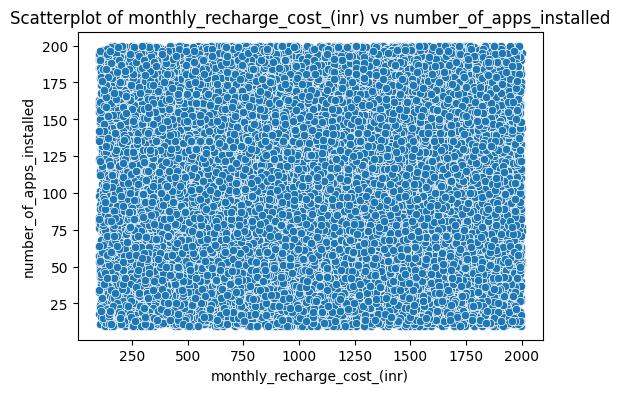

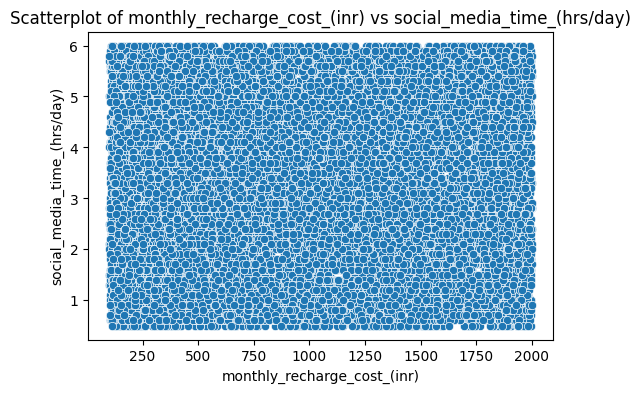

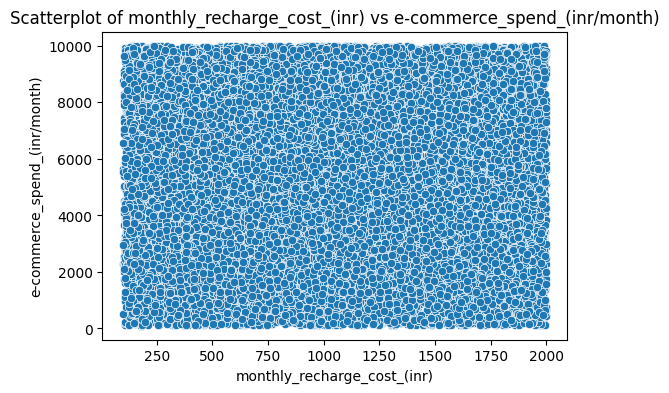

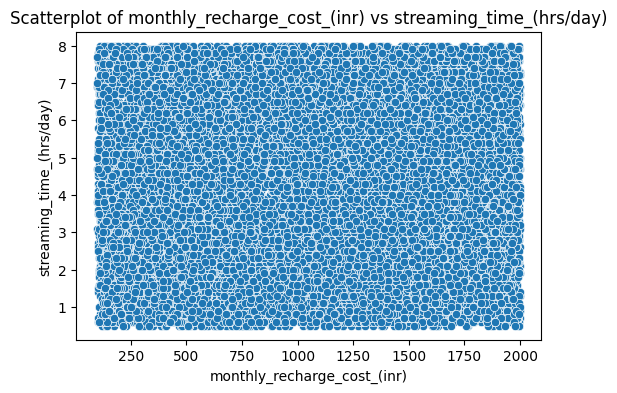

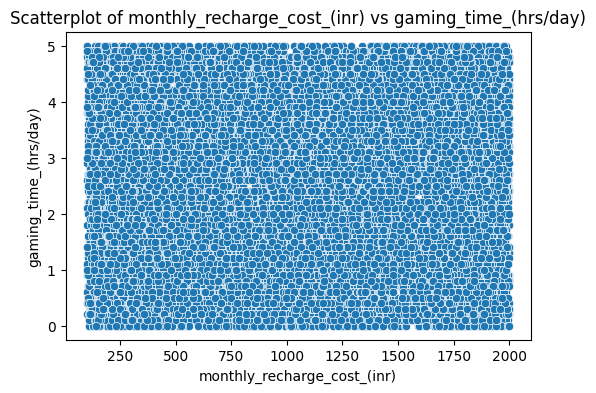

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 6))
numeric_df = df.select_dtypes(include=['float64', 'int64'])
plt.figure(figsize=(10, 6))
sns.heatmap(numeric_df.corr(), annot=True, cmap='coolwarm', fmt='.2f')
plt.title("Correlation Heatmap")
plt.show()
numeric_df = df.select_dtypes(include=['float64', 'int64'])
sns.pairplot(numeric_df)
plt.suptitle("Pairplot of Numerical Features", y=1.02)
plt.show()

plt.figure(figsize=(12, 8))
for col1 in numeric_df.columns:
    for col2 in numeric_df.columns:
        if col1 != col2:
            plt.figure(figsize=(6, 4))
            sns.scatterplot(x=df[col1], y=df[col2])
            plt.title(f"Scatterplot of {col1} vs {col2}")
            plt.xlabel(col1)
            plt.ylabel(col2)
            plt.show()

if 'date' in df.columns:
    df['date'] = pd.to_datetime(df['date'])
    plt.figure(figsize=(12, 6))
    sns.lineplot(x='date', y='screen_time_(hrs/day)', data=df)
    plt.title("Screen Time Trend Over Time")
    plt.xlabel("Date")
    plt.ylabel("Screen Time (hrs/day)")
    plt.xticks(rotation=45)
    plt.show()


TIME SERIES PLOT

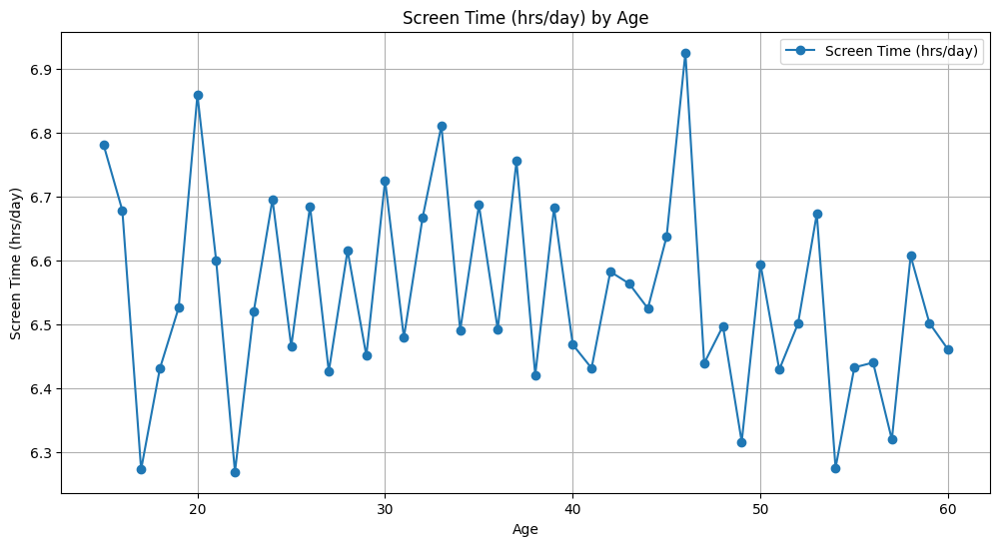

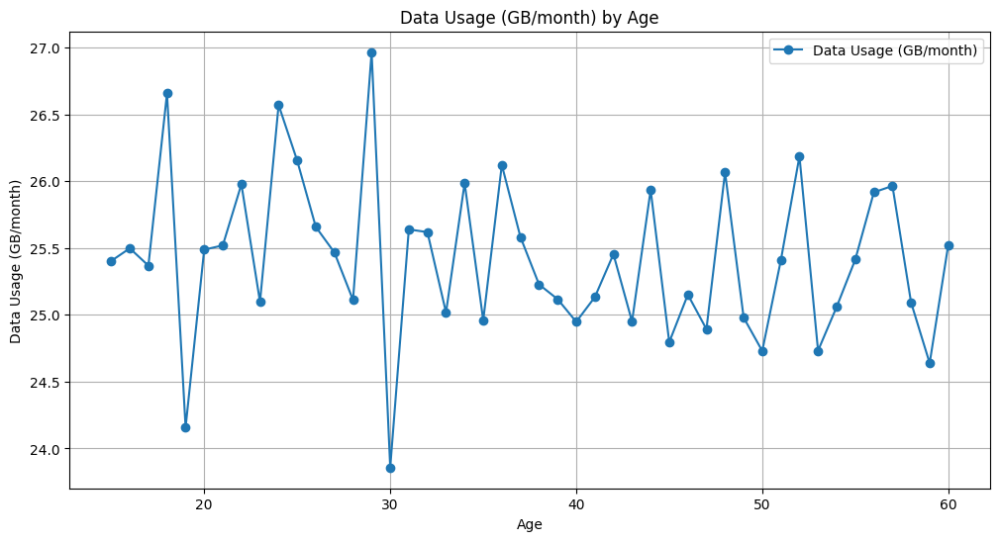

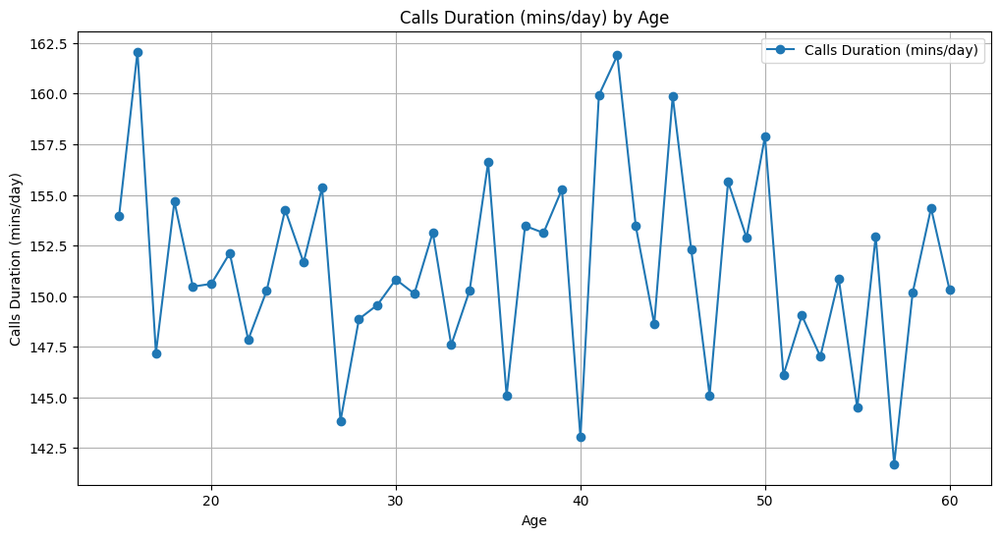

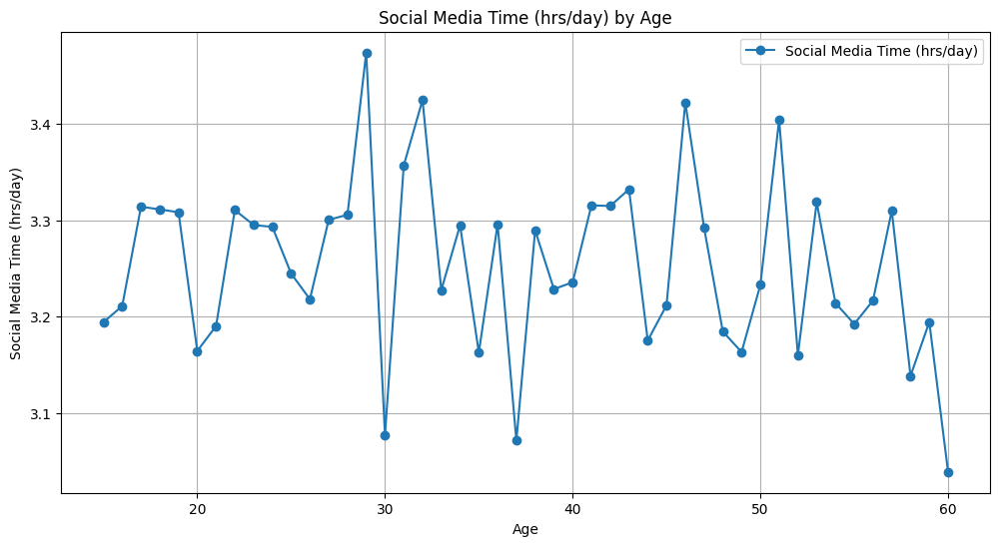

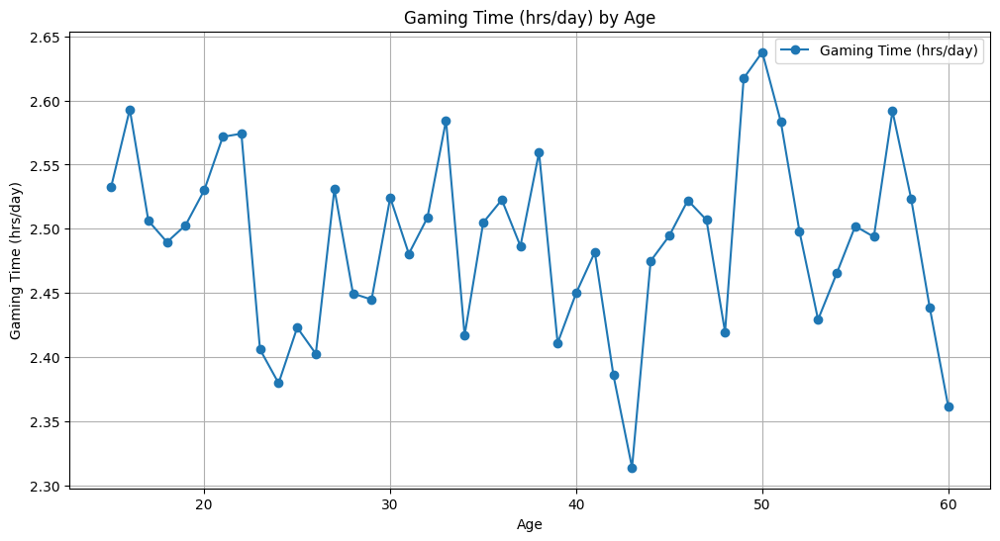

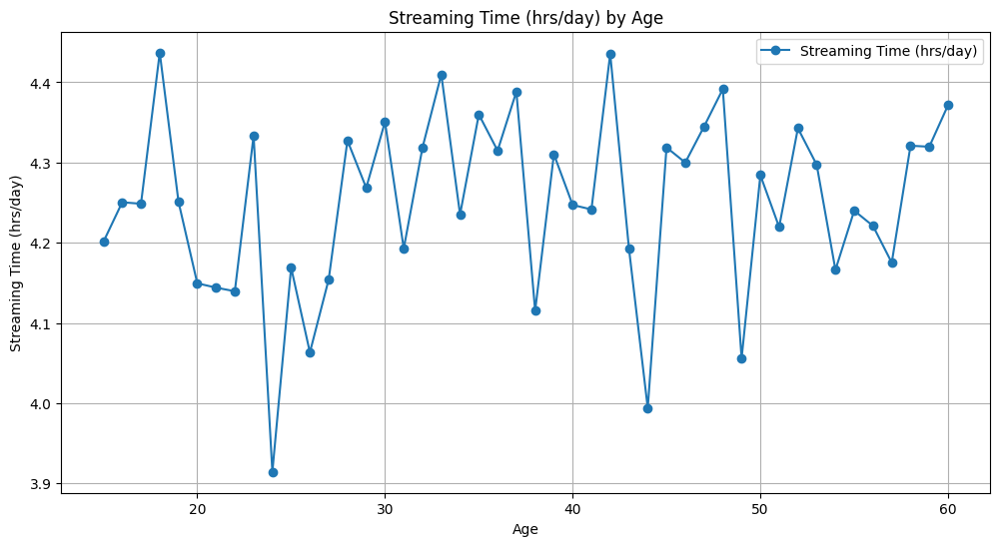

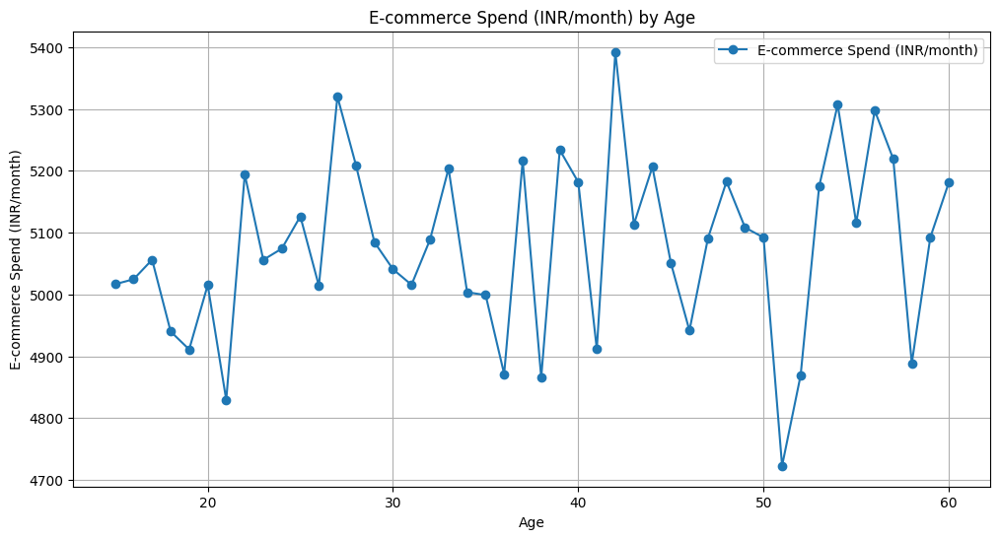

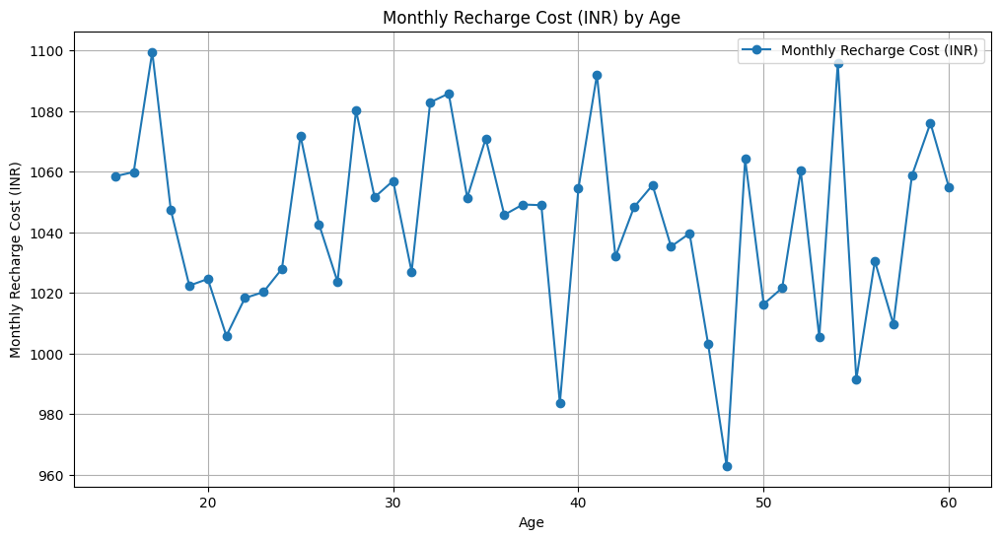

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
file_path = "phone_usage_india.csv"
df = pd.read_csv(file_path)
def plot_trend_over_age(column_name):
    df_grouped = df.groupby("Age")[column_name].mean()
    plt.figure(figsize=(12, 6))
    plt.plot(df_grouped.index, df_grouped.values, marker='o', linestyle='-', label=column_name)
    plt.xlabel("Age")
    plt.ylabel(column_name)
    plt.title(f"{column_name} by Age")
    plt.legend()
    plt.grid()
    plt.show()
time_series_columns = [
    "Screen Time (hrs/day)",
    "Data Usage (GB/month)",
    "Calls Duration (mins/day)",
    "Social Media Time (hrs/day)",
    "Gaming Time (hrs/day)",
    "Streaming Time (hrs/day)",
    "E-commerce Spend (INR/month)",
    "Monthly Recharge Cost (INR)"
]

for col in time_series_columns:
    plot_trend_over_age(col)


HISTOGRAM

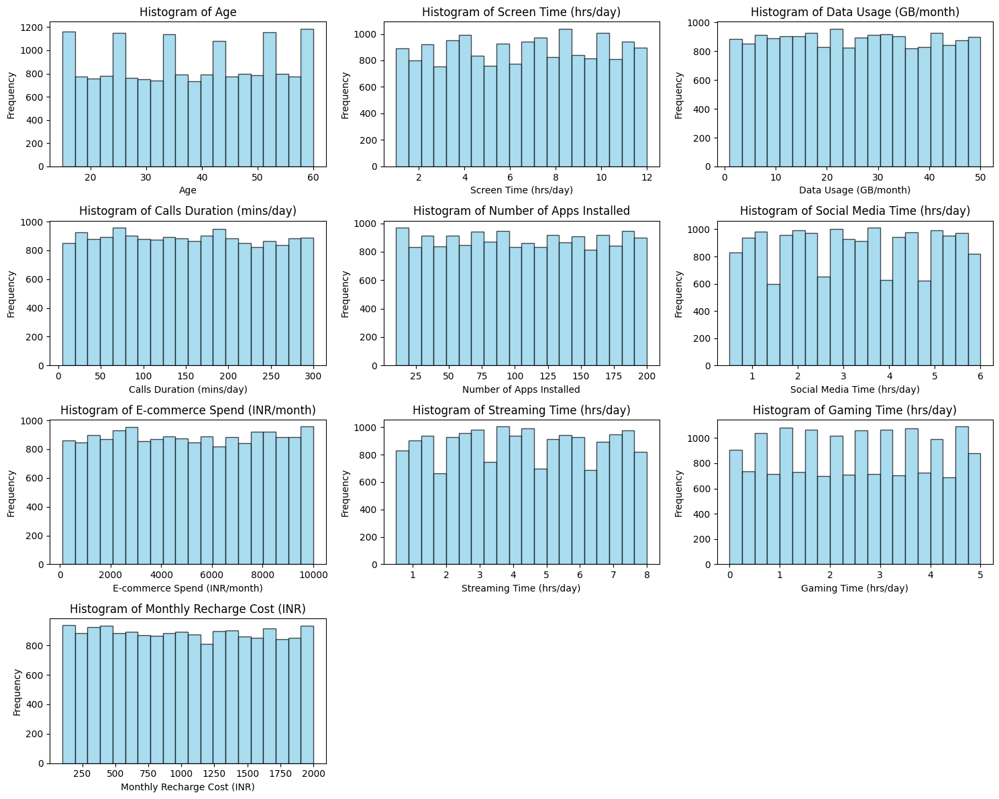

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

file_path = "phone_usage_india.csv"
df = pd.read_csv(file_path)

num_columns = [
    "Age", "Screen Time (hrs/day)", "Data Usage (GB/month)", "Calls Duration (mins/day)",
    "Number of Apps Installed", "Social Media Time (hrs/day)", "E-commerce Spend (INR/month)",
    "Streaming Time (hrs/day)", "Gaming Time (hrs/day)", "Monthly Recharge Cost (INR)"
]

plt.figure(figsize=(15, 12))
for i, col in enumerate(num_columns, 1):
    plt.subplot(4, 3, i)
    plt.hist(df[col], bins=20, color='skyblue', alpha=0.7, edgecolor='black')
    plt.xlabel(col)
    plt.ylabel("Frequency")
    plt.title(f"Histogram of {col}")
plt.tight_layout()
plt.show()


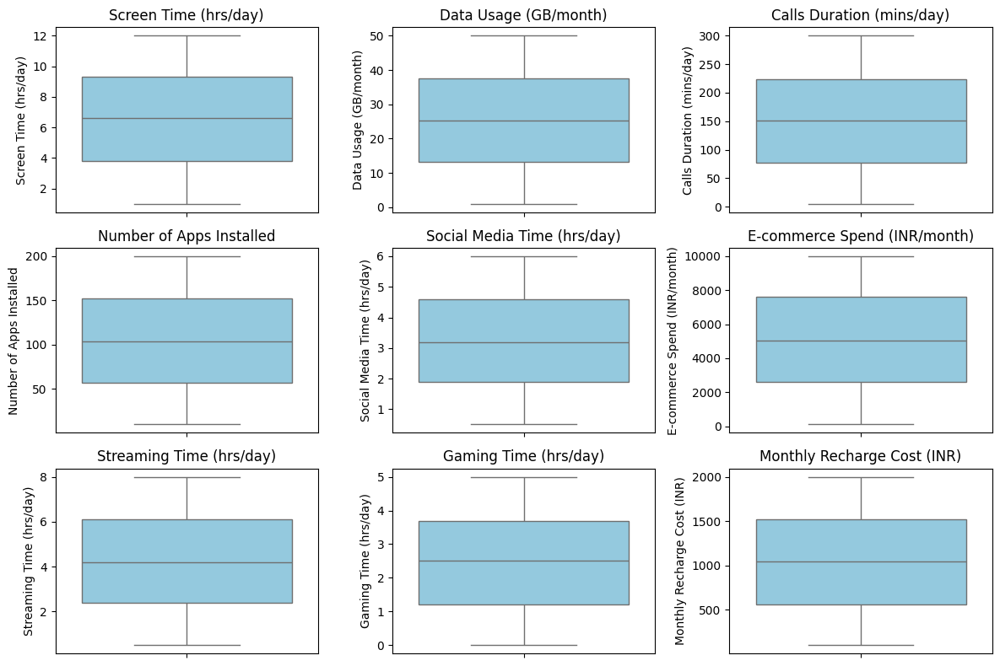

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
file_path = "phone_usage_india.csv"
df = pd.read_csv(file_path)
numerical_columns = [
    "Screen Time (hrs/day)", "Data Usage (GB/month)", "Calls Duration (mins/day)",
    "Number of Apps Installed", "Social Media Time (hrs/day)", "E-commerce Spend (INR/month)",
    "Streaming Time (hrs/day)", "Gaming Time (hrs/day)", "Monthly Recharge Cost (INR)"
]

plt.figure(figsize=(12, 8))
for i, col in enumerate(numerical_columns, 1):
    plt.subplot(3, 3, i)
    sns.boxplot(data=df[col], color="skyblue")
    plt.title(col)
    plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

FEATURE ENGINEERING

In [ ]:
import pandas as pd
print("Original Columns: ", df.columns)
if 'date' in df.columns:
    df['date'] = pd.to_datetime(df['date'], errors='coerce')
    df['day_of_week'] = df['date'].dt.day_name()
if 'time' in df.columns:
    df['time'] = pd.to_datetime(df['time'], errors='coerce')
    df['hour'] = df['time'].dt.hour
    df['time_of_day'] = pd.cut(df['hour'], bins=[0, 6, 12, 18, 24], labels=['Night', 'Morning', 'Afternoon', 'Evening'], right=False)
if {'social_media_time_hrs_day', 'streaming_time_hrs_day', 'gaming_time_hrs_day'}.issubset(df.columns):
    df['entertainment_time_hrs_day'] = df['streaming_time_hrs_day'] + df['gaming_time_hrs_day']
    df['productive_time_hrs_day'] = df['screen_time_hrs_day'] - df[['social_media_time_hrs_day', 'streaming_time_hrs_day', 'gaming_time_hrs_day']].sum(axis=1)

if 'day_of_week' in df.columns:
    df['day_of_week_encoded'] = df['day_of_week'].astype('category').cat.codes

if 'time_of_day' in df.columns:
    df['time_of_day_encoded'] = df['time_of_day'].astype('category').cat.codes


print("Feature Engineering Completed!")
print(df.head())

df.to_csv("phone_usage_with_features.csv", index=False)


Original Columns:  Index(['User ID', 'Age', 'Gender', 'Location', 'Phone Brand', 'OS',
       'Screen Time (hrs/day)', 'Data Usage (GB/month)',
       'Calls Duration (mins/day)', 'Number of Apps Installed',
       'Social Media Time (hrs/day)', 'E-commerce Spend (INR/month)',
       'Streaming Time (hrs/day)', 'Gaming Time (hrs/day)',
       'Monthly Recharge Cost (INR)', 'Primary Use'],
      dtype='object')
Feature Engineering Completed!
  User ID  Age  Gender   Location Phone Brand       OS  Screen Time (hrs/day)  \
0  U00001   53    Male     Mumbai        Vivo  Android                    3.7   
1  U00002   60   Other      Delhi      Realme      iOS                    9.2   
2  U00003   37  Female  Ahmedabad       Nokia  Android                    4.5   
3  U00004   32    Male       Pune     Samsung  Android                   11.0   
4  U00005   16    Male     Mumbai      Xiaomi      iOS                    2.2   

   Data Usage (GB/month)  Calls Duration (mins/day)  Number of Apps 

DATA SPLITTING

In [ ]:
from sklearn.model_selection import train_test_split
target_col = [col for col in df.columns if 'Screen Time' in col][0]
X = df.drop(columns=[target_col])
y = df[target_col]
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.3, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)
print(f"Training set: {X_train.shape}, {y_train.shape}")
print(f"Validation set: {X_val.shape}, {y_val.shape}")
print(f"Test set: {X_test.shape}, {y_test.shape}")

Training set: (12380, 15), (12380,)
Validation set: (2653, 15), (2653,)
Test set: (2653, 15), (2653,)


LINEAR REGRESSION

Mean Squared Error: 9.88
R-squared: -0.00


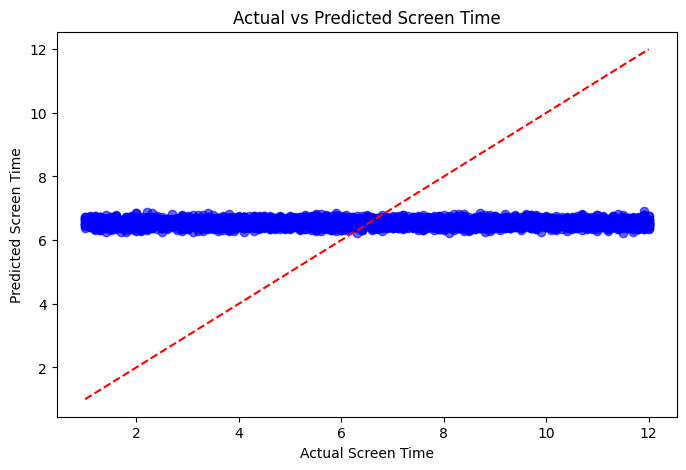

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt
screen_time_col = [col for col in df.columns if 'Screen Time' in col][0]
X = df.drop(columns=[screen_time_col])
y = df[screen_time_col]
label_encoders = {}
for col in X.select_dtypes(include=['object']).columns:
    label_encoders[col] = LabelEncoder()
    X[col] = label_encoders[col].fit_transform(X[col])
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
model = LinearRegression()
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)
print(f"Mean Squared Error: {mse:.2f}")
print(f"R-squared: {r2:.2f}")
plt.figure(figsize=(8, 5))
plt.scatter(y_test, y_pred, color='blue', alpha=0.6)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], '--', color='red')
plt.xlabel("Actual Screen Time")
plt.ylabel("Predicted Screen Time")
plt.title("Actual vs Predicted Screen Time")
plt.show()

DECISION TREE WITH DEPTH-4

Mean Squared Error: 9.98
R^2 Score: -0.01


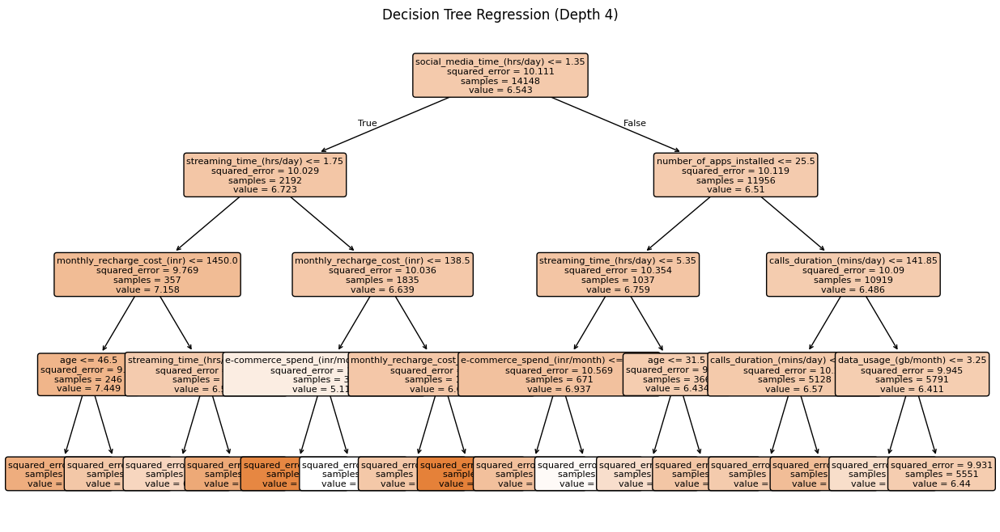

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, r2_score
df = pd.read_csv("/content/cleaned_phone_usage_data.csv")
target_col = [col for col in df.columns if 'screen_time' in col][0]
df_numeric = df.select_dtypes(include=['number']).copy()
if target_col not in df_numeric.columns:
    df_numeric[target_col] = df[target_col]

X = df_numeric.drop(columns=[target_col])
y = df_numeric[target_col]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
model = DecisionTreeRegressor(max_depth=4, random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error: {mse:.2f}")
print(f"R^2 Score: {r2:.2f}")

import matplotlib.pyplot as plt
from sklearn import tree

plt.figure(figsize=(15, 8))
tree.plot_tree(model, feature_names=X.columns, filled=True, rounded=True, fontsize=8)
plt.title("Decision Tree Regression (Depth 4)")
plt.show()


DECISION TREE

Index(['user_id', 'age', 'gender', 'location', 'phone_brand', 'os',
       'screen_time_(hrs/day)', 'data_usage_(gb/month)',
       'calls_duration_(mins/day)', 'number_of_apps_installed',
       'social_media_time_(hrs/day)', 'e-commerce_spend_(inr/month)',
       'streaming_time_(hrs/day)', 'gaming_time_(hrs/day)',
       'monthly_recharge_cost_(inr)', 'primary_use'],
      dtype='object')
Mean Squared Error: 20.23
R^2 Score: -1.05


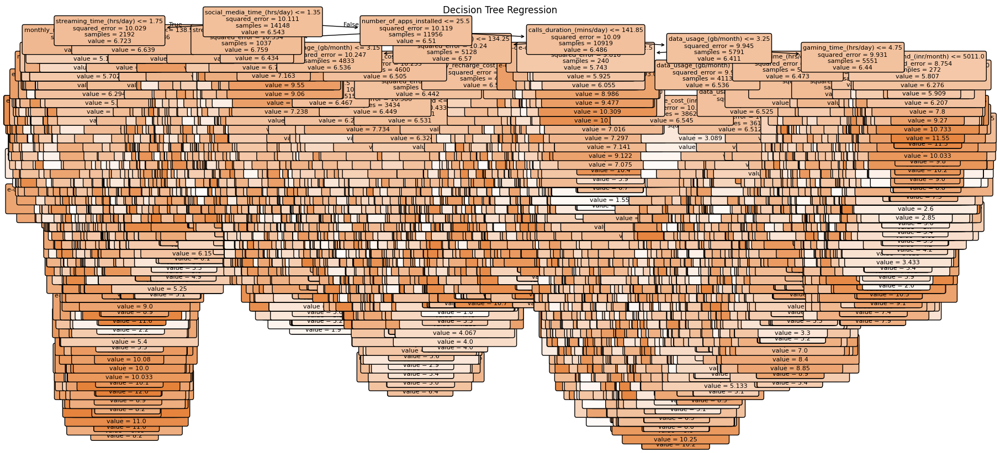

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib.pyplot as plt
from sklearn import tree
df = pd.read_csv("cleaned_phone_usage_data.csv")
print(df.columns)
target_col = [col for col in df.columns if 'screen_time' in col][0]

df_numeric = df.select_dtypes(include=['number']).copy()

if target_col not in df_numeric.columns:
    df_numeric[target_col] = df[target_col]

X = df_numeric.drop(columns=[target_col])
y = df_numeric[target_col]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
model = DecisionTreeRegressor(random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"Mean Squared Error: {mse:.2f}")
print(f"R^2 Score: {r2:.2f}")
plt.figure(figsize=(20, 10))
tree.plot_tree(model, feature_names=X.columns, filled=True, rounded=True, fontsize=8)
plt.title("Decision Tree Regression")
plt.show()


RANDOM FOREST REGRESSION

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score
import numpy as np
screen_time_col = [col for col in df.columns if 'screen_time' in col][0]
X = df.drop(columns=[screen_time_col])
y = df[screen_time_col]
for col in X.select_dtypes(include=['object']).columns:
    X[col] = X[col].astype('category').cat.codes
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)

rf_model.fit(X_train, y_train)

y_pred = rf_model.predict(X_test)

mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)
print(f'Mean Squared Error (MSE): {mse:.2f}')
print(f'Root Mean Squared Error (RMSE): {rmse:.2f}')
print(f'R-squared (R2): {r2:.2f}')

Mean Squared Error (MSE): 10.10
Root Mean Squared Error (RMSE): 3.18
R-squared (R2): -0.02


Gradient Boosting (XGBoost and AdaBoost)

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import AdaBoostRegressor
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import LabelEncoder

df = pd.read_csv("cleaned_phone_usage_data.csv")

screen_time_col = [col for col in df.columns if 'screen_time' in col][0]

categorical_cols = df.select_dtypes(include=['object']).columns.tolist()

label_encoders = {}
for col in categorical_cols:
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col])
    label_encoders[col] = le

X = df.drop(columns=[screen_time_col])
y = df[screen_time_col]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

xgb_model = XGBRegressor(objective='reg:squarederror', n_estimators=100, random_state=42)
xgb_model.fit(X_train, y_train)
xgb_preds = xgb_model.predict(X_test)

adaboost_model = AdaBoostRegressor(n_estimators=100, random_state=42)
adaboost_model.fit(X_train, y_train)
adaboost_preds = adaboost_model.predict(X_test)

def evaluate_model(model_name, y_test, preds):
    mse = mean_squared_error(y_test, preds)
    r2 = r2_score(y_test, preds)
    print(f"{model_name} Performance:")
    print(f"Mean Squared Error: {mse:.2f}")
    print(f"R² Score: {r2:.2f}\n")

evaluate_model("XGBoost", y_test, xgb_preds)
evaluate_model("AdaBoost", y_test, adaboost_preds)


XGBoost Performance:
Mean Squared Error: 11.31
R² Score: -0.14

AdaBoost Performance:
Mean Squared Error: 9.88
R² Score: 0.00



MODEL TRAINING

In [ ]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_squared_error, r2_score
target_col = [col for col in df.columns if 'screen_time' in col][0]
X = df.drop(columns=[target_col])
y = df[target_col]
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)
ridge = Ridge()

param_grid = {'alpha': [0.1, 1.0, 10.0, 100.0]}

grid_search = GridSearchCV(ridge, param_grid, cv=5, scoring='neg_mean_squared_error')
grid_search.fit(X_train, y_train)

best_params = grid_search.best_params_
print("Best Hyperparameters:", best_params)

best_model = grid_search.best_estimator_

y_pred = best_model.predict(X_val)

mse = mean_squared_error(y_val, y_pred)
r2 = r2_score(y_val, y_pred)

print(f'Mean Squared Error (MSE): {mse:.2f}')
print(f'R-Squared (R2): {r2:.2f}')


Best Hyperparameters: {'alpha': 100.0}
Mean Squared Error (MSE): 9.88
R-Squared (R2): -0.00


MODEL EVALUATION

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

target_col = [col for col in df.columns if 'screen_time' in col][0]

X = df.drop(columns=[target_col])
y = df[target_col]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model = LinearRegression()
model.fit(X_train, y_train)

y_pred = model.predict(X_test)

rmse = np.sqrt(mean_squared_error(y_test, y_pred))
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"RMSE: {rmse:.3f}")
print(f"MAE: {mae:.3f}")
print(f"R²: {r2:.3f}")


RMSE: 3.144
MAE: 2.716
R²: -0.000


In [ ]:
from sklearn.model_selection import cross_val_score, StratifiedKFold
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import AdaBoostClassifier
from xgboost import XGBClassifier
from sklearn.metrics import make_scorer, accuracy_score
import numpy as np
import pandas as pd

In [ ]:
print(df.columns.tolist())

['user_id', 'age', 'gender', 'location', 'phone_brand', 'os', 'screen_time_(hrs/day)', 'data_usage_(gb/month)', 'calls_duration_(mins/day)', 'number_of_apps_installed', 'social_media_time_(hrs/day)', 'e-commerce_spend_(inr/month)', 'streaming_time_(hrs/day)', 'gaming_time_(hrs/day)', 'monthly_recharge_cost_(inr)', 'primary_use']


In [ ]:
import pandas as pd
df = pd.read_csv("phone_usage_india.csv")
print(df.head())

  User ID  Age  Gender   Location Phone Brand       OS  Screen Time (hrs/day)  \
0  U00001   53    Male     Mumbai        Vivo  Android                    3.7   
1  U00002   60   Other      Delhi      Realme      iOS                    9.2   
2  U00003   37  Female  Ahmedabad       Nokia  Android                    4.5   
3  U00004   32    Male       Pune     Samsung  Android                   11.0   
4  U00005   16    Male     Mumbai      Xiaomi      iOS                    2.2   

   Data Usage (GB/month)  Calls Duration (mins/day)  Number of Apps Installed  \
0                   23.9                       37.9                       104   
1                   28.1                       13.7                       169   
2                   12.3                       66.8                        96   
3                   25.6                      156.2                       146   
4                    2.5                      236.2                        86   

   Social Media Time (hrs/

In [ ]:
import pandas as pd
df = pd.read_csv("phone_usage_india.csv")
df.columns = df.columns.str.strip().str.lower().str.replace(' ', '_')
print(df.columns.tolist())

['user_id', 'age', 'gender', 'location', 'phone_brand', 'os', 'screen_time_(hrs/day)', 'data_usage_(gb/month)', 'calls_duration_(mins/day)', 'number_of_apps_installed', 'social_media_time_(hrs/day)', 'e-commerce_spend_(inr/month)', 'streaming_time_(hrs/day)', 'gaming_time_(hrs/day)', 'monthly_recharge_cost_(inr)', 'primary_use']


In [ ]:
print([col for col in df.columns if 'screen' in col])

['screen_time_(hrs/day)']


In [ ]:
X = df.drop('screen_time_(hrs/day)', axis=1)
y = df['screen_time_(hrs/day)']

In [ ]:
df = df.drop('user_id', axis=1)
df = pd.get_dummies(df)
X = df.drop('screen_time_(hrs/day)', axis=1)
y = df['screen_time_(hrs/day)']

In [ ]:
from sklearn.model_selection import cross_val_score, KFold
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import AdaBoostRegressor
from xgboost import XGBRegressor
import numpy as np
import pandas as pd
cv = KFold(n_splits=10, shuffle=True, random_state=42)
models = {
    "Decision Tree": DecisionTreeRegressor(random_state=42),
    "XGBoost": XGBRegressor(random_state=42, objective='reg:squarederror'),
    "AdaBoost": AdaBoostRegressor(random_state=42)
}
cv_results = {}
for name, model in models.items():
    scores = cross_val_score(model, X, y, cv=cv, scoring='r2')
    cv_results[name] = scores
    print(f"{name} R^2 Scores:\n{scores}")
    print(f"{name} Mean R^2: {scores.mean():.4f}, Std: {scores.std():.4f}\n")
results_df = pd.DataFrame(cv_results)

Decision Tree R^2 Scores:
[-1.16811899 -1.17593    -0.94152173 -1.04695167 -1.08838186 -1.03098435
 -1.09107539 -0.97628608 -0.95906668 -1.07918327]
Decision Tree Mean R^2: -1.0558, Std: 0.0770

XGBoost R^2 Scores:
[-0.11181408 -0.15068893 -0.11753539 -0.12663511 -0.14337549 -0.09127984
 -0.10961507 -0.09585318 -0.10843135 -0.12518874]
XGBoost Mean R^2: -0.1180, Std: 0.0180

AdaBoost R^2 Scores:
[-0.01185379 -0.00081712 -0.00292502 -0.00282185 -0.00231154 -0.00163052
 -0.00153582 -0.00128645 -0.00094855 -0.00457847]
AdaBoost Mean R^2: -0.0031, Std: 0.0031



--> ADABOOST IS PERFORMING BEST

ANNOVA TEST

In [ ]:
from scipy.stats import f_oneway
f_stat, p_value = f_oneway(
    results_df["Decision Tree"],
    results_df["XGBoost"],
    results_df["AdaBoost"]
)
print(f"ANOVA F-statistic: {f_stat:.4f}")
print(f"ANOVA p-value: {p_value:.4f}")

ANOVA F-statistic: 1436.4754
ANOVA p-value: 0.0000


T-TEST

In [ ]:
from scipy.stats import ttest_rel
# Decision Tree vs XGBoost
t1, p1 = ttest_rel(results_df["Decision Tree"], results_df["XGBoost"])
print(f"\nDecision Tree vs XGBoost: t = {t1:.4f}, p = {p1:.4f}")
# XGBoost vs AdaBoost
t2, p2 = ttest_rel(results_df["XGBoost"], results_df["AdaBoost"])
print(f"XGBoost vs AdaBoost: t = {t2:.4f}, p = {p2:.4f}")
# Decision Tree vs AdaBoost
t3, p3 = ttest_rel(results_df["Decision Tree"], results_df["AdaBoost"])
print(f"Decision Tree vs AdaBoost: t = {t3:.4f}, p = {p3:.4f}")


Decision Tree vs XGBoost: t = -40.5781, p = 0.0000
XGBoost vs AdaBoost: t = -18.7181, p = 0.0000
Decision Tree vs AdaBoost: t = -41.7260, p = 0.0000


z-test

In [ ]:
import pandas as pd
from scipy import stats
import numpy as np
df = pd.read_csv('/content/phone_usage_india.csv')
column = 'Calls Duration (mins/day)'
sample_data = df[column].dropna()
sample_mean = sample_data.mean()
sample_std = sample_data.std()
n = len(sample_data)
population_mean = 100
z_score = (sample_mean - population_mean) / (sample_std / np.sqrt(n))
p_value = 2 * (1 - stats.norm.cdf(abs(z_score)))
print(f"Sample Mean: {sample_mean:.2f}")
print(f"Sample Size: {n}")
print(f"Z-Score: {z_score:.3f}")
print(f"P-Value: {p_value:.4f}")
alpha = 0.05
if p_value < alpha:
    print("Reject the null hypothesis: Call duration is significantly different from 100 minutes/day.")
else:
    print("Fail to reject the null hypothesis: No significant difference from 100 minutes/day.")

Sample Mean: 151.41
Sample Size: 17686
Z-Score: 80.501
P-Value: 0.0000
Reject the null hypothesis: Call duration is significantly different from 100 minutes/day.


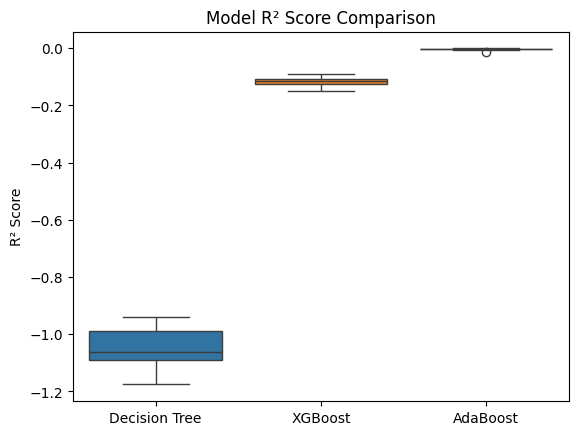

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
sns.boxplot(data=results_df)
plt.title("Model R² Score Comparison")
plt.ylabel("R² Score")
plt.show()

CHI SQUARE TEST IS NOT APPLICABLE AS THERE IS NO CATEGORICAL DATA

We compared the R² performance of three regression models (Decision Tree, XGBoost, and AdaBoost) using 10-fold cross-validation.
Statistical tests (ANOVA and pairwise T-tests) were conducted to determine if differences in performance were significant.
Results showed that AdaBoost significantly outperformed the other two models (p < 0.05) in terms of predictive accuracy.